In [1]:
%load_ext autoreload
%autoreload 2
    
import os
import transformers
import pdb
import wandb
import torch
from torch import nn
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import evaluate
from tqdm.auto import tqdm
from pathlib import Path
from torch.utils.data import DataLoader
from torchvision.io import read_image
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import random_split
from torchvision import datasets, models, transforms
from torch.utils.data import WeightedRandomSampler
from sklearn.utils.class_weight import compute_class_weight
from PIL import Image, ImageDraw, ImageFont



#from src.dataset import NAIPImagery
#from src.config import Config
#from src.sampler import BalancedBatchSampler
#from src.prompts import prompting

from transformers import (
    VisionTextDualEncoderModel,
    VisionTextDualEncoderProcessor,
    AutoTokenizer,
    AutoImageProcessor
)

# Take care of cuda
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
torch.backends.cudnn.benchmark = True

# Do config
#config =  Config("config_prompts.yaml")
#config_train = config.train_config

/home/topcat/mambaforge/envs/cs231n_project/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Evaluate the CLIP-esque results

In [390]:
def calculate_metrics(labs, preds):
    
    metrics = {}
    accuracy_metric = evaluate.load("accuracy")
    f1_metric = evaluate.load("f1")
    acc = accuracy_metric.compute(references=labs, predictions=preds)
    f1 = f1_metric.compute(references=labs, predictions=preds, average="weighted")
    
    metrics.update(acc)
    metrics.update(f1)
    
    return metrics

def evaluate_dual_enc_df(df, processor, model):
    """ Process evaluation for a test DataFrame
    """
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
    # Do evaluation for each example
    real_labels = []
    predict_label = []
    for idx, row in tqdm(df.iterrows(), total=df.shape[0], 
                         desc="Evaluating each pair img/text",
                         position=0
                        ):
        #original_caption = row.caption_column.rstrip()
        label = int(row["label"])
        real_labels.append(label)


        # if row["label"] == "1":
        #     real_caption = f"{original_caption}. This house is burned"
        #     fake_caption = f"{original_caption}. This house is not burned"
        # elif row["label"] == "0":
        #     real_caption = f"{original_caption}. This house is not burned"
        #     fake_caption = f"{original_caption}. This house is burned"
        # else:
        #     pass
        real_caption = row["caption_column"]
                            
        if label == 0:
            fake_label = "burned"
        elif label == 1:
            fake_label = "not burned"

        fake_caption = f"{real_caption.rsplit(' ', 1)[0]} {fake_label}"
        
        # Now open images and pass the same image for the two prompts
        images = [Image.open(row["image_column"]) for _ in range(2)]
        inputs = processor(text = [real_caption, fake_caption], images=images, return_tensors="pt", padding=True)
        inputs = {k: v.to(device) for k, v in inputs.items()}
        
        # Do model inference

        with torch.no_grad():
            model = model.to(device)
            outputs = model(**inputs)
            logits_per_image = outputs.logits_per_image  
            probs = logits_per_image.softmax(dim=1) 
        
        # Calculate predicted label
        arr = probs.cpu().detach().numpy()
        arr = np.diag(arr)
        
        win = np.argmax(arr,axis=0)
        if win == 0:
            pred = label
        else:
            pred = 1 - label
        
        predict_label.append(pred)
        
    return real_labels, predict_label

    
def evaluate_dual_enc_model(path_to_test,
                            path_to_model,
                            name_text,
                            name_vision,
                            k=10,
                            return_sample=False,
                            do_checkpoints=True
                           ):
    
    
    # Instantiate model and processor
    tokenizer = AutoTokenizer.from_pretrained(name_text)
    image_processor = AutoImageProcessor.from_pretrained(name_vision)
    processor = VisionTextDualEncoderProcessor(image_processor, tokenizer)

    # Read in text data
    test_data = pd.read_csv(path_to_test)
    sample_df = test_data.groupby("label").sample(k // 2, 
                                 random_state=np.random.RandomState(42),
                                 replace=True)
    
    if do_checkpoints:
        checkpoints = list(Path(path_to_model).rglob("checkpoint*"))
        num_checkpoints = [str(ls).split("-")[-1] for ls in checkpoints]
        
        metrics_list = []
        for check, epoch in tqdm(zip(checkpoints, num_checkpoints), desc="Processing for each checkpoint",
                                position=1, leave=False):
            model = VisionTextDualEncoderModel.from_pretrained(check)
            labs, preds = evaluate_dual_enc_df(sample_df, processor, model)
            metrics = calculate_metrics(labs, preds)
            
            metrics.update({"epoch": int(epoch)})
            
            metrics_list.append(metrics)
        
        return metrics_list
            
    
    else:
        # Do last checkpoint
        list_checkpoints = [s.name for s in list(Path(path_to_model).rglob("checkpoint*"))]
        list_checkpoints.sort(key=lambda x: int(str(x).split("-")[1]))
        last_checkpoint = os.path.join(path_to_model, list_checkpoints[-1])
        
        model =  VisionTextDualEncoderModel.from_pretrained(last_checkpoint)
        labs, preds = evaluate_dual_enc_df(sample_df, processor, model)
        metrics = calculate_metrics(labs, preds)

        if return_sample:
            out = (metrics, sample_df)
        else:
            out = metrics
        
        return out

def show_maps_grid(grid_size, 
                   df,
                   size=50,
                   column_to_print="label",
                   column_image = "image_column"
                  ):

    # Get columns from data frame
    image_list = df[column_image].tolist()
    text_print = df[column_to_print].tolist()
                       
    # Define sample for grid
    rows, cols = grid_size
    n_images = rows * cols
    sample_images = image_list[0:n_images]

    raw_imgs = []
    for s in sample_images:
        image = Image.open(s)
        raw_imgs.append(image.resize((500, 500)))
        
    # Build grid
    w, h = raw_imgs[0].size # must be 500, 500                   
    font = ImageFont.truetype("/home/topcat/.local/share/fonts/Inconsolata Bold for Powerline.ttf", size)

    grid_raw = Image.new('RGB', size=(cols*w, rows*h))
    for i, img_label in enumerate(zip(raw_imgs, text_print)):
        img, txt = img_label
        draw = ImageDraw.Draw(img)
        
        draw.text((10, 10), str(txt), fill="DeepPink", font=font)
        grid_raw.paste(img, box=(i%cols*w, i//cols*h))
        
    return grid_raw

### Run evaluation on single model

In [395]:
metrics, sample_df = evaluate_dual_enc_model(path_to_test="data/train_data_shots.csv",  
                                      name_text="roberta-base",
                                      name_vision="google/vit-base-patch16-224",
                                      path_to_model="/mnt/sherlock/scratch/vit-roberta-finetuned-supervised-very-small-k",
                                      k=50,
                                      do_checkpoints=False,
                                      return_sample=True
                                     )

Evaluating each pair img/text: 100%|█████████████████████████████████████| 50/50 [00:04<00:00, 11.58it/s]


In [396]:
metrics

{'accuracy': 0.9, 'f1': 0.898989898989899}

In [410]:
test_data = pd.read_csv("data/train_data.csv")
sample_df = test_data.groupby("label").sample(50, 
                             random_state=np.random.RandomState(42),
                             replace=True)
sample_df["idx"] = np.arange(0, len(sample_df))
sample_df

,image_column,caption_column,label,idx
1273,data/train/21094_ca_m_3712040_nw_10_.6_2016062...,This house is nan years old. It is located 586...,0,0
8392,data/train/9899_ca_m_3912112_nw_10_060_2018071...,This house is nan years old. It is located 730...,0,1
8157,data/train/22307_ca_m_3812229_sw_10_060_202005...,This house is 55.0 years old. It is located 98...,0,2
8103,data/train/12341_ca_m_3812211_nw_10_1_20140604...,This house is 77.0 years old. It is located 63...,0,3
5852,data/train/26492_ca_m_3812240_se_10_060_202005...,This house is 7.0 years old. It is located 103...,0,4
...,...,...,...,...
8683,data/train/27021_ca_m_3812227_se_10_.6_2016061...,This house is 27.0 years old. It is located 34...,1,95
3415,data/train/26508_ca_m_3812240_se_10_060_202005...,This house is 58.0 years old. It is located 11...,1,96
5804,data/train/29708_ca_m_3812236_sw_10_.6_2016061...,This house is 32.0 years old. It is located 35...,1,97
167,data/train/5709_ca_m_3912112_sw_10_060_2018071...,This house is 18.0 years old. It is located 60...,1,98


In [426]:
filtered = sample_df[~sample_df.idx.isin([0, 2, 3, 5, 6, 8, 11, 13, 14, 16, 19, 25, 42, 53, 55, 47, 57, 73, 77, 64, 
                              86, 87, 88, 79])]
filtered.to_csv("data/test_cleaned_small.csv", index=False)


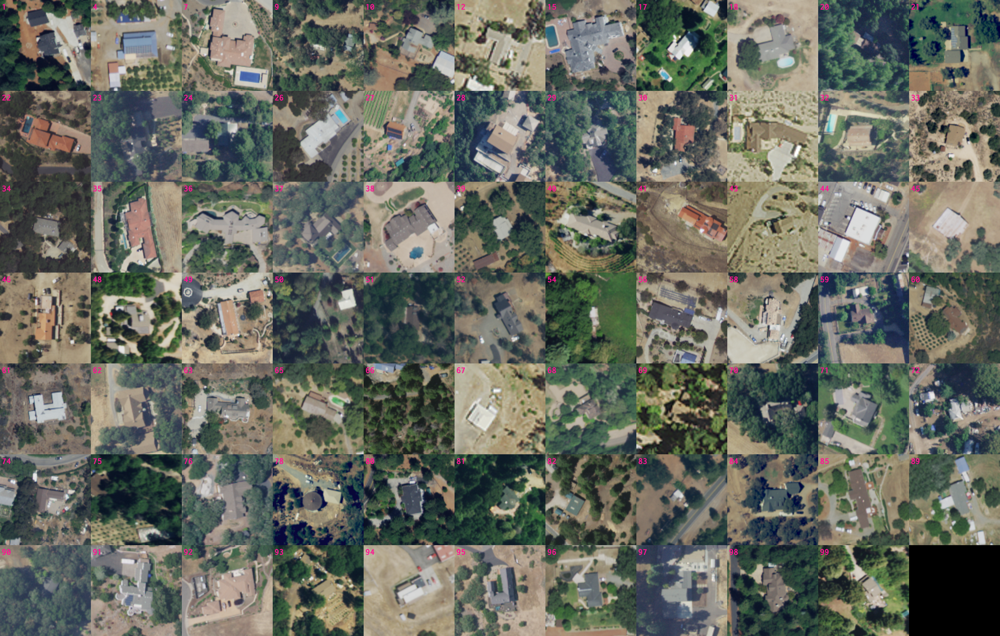

In [417]:
show_maps_grid((7, 11), filtered, column_to_print="idx")

### Run evaluation on k-shot with last checkpoint

In [435]:
np.arange(1, 10, 2)

array([1, 3, 5, 7, 9])

In [444]:
metrics_shot = []
for k in range(1, 21):
    metrics = evaluate_dual_enc_model(path_to_test="data/test_cleaned_small.csv",  
                                          name_text="gpt2-medium",
                                          name_vision="google/vit-base-patch16-224",
                                          path_to_model=f"/mnt/sherlock/scratch/vit-gpt-finetuned-supervised-very-small-{k}/",
                                          k=20,
                                          do_checkpoints=False
                                         )
    metrics.update({"shot": int(k)})
    metrics_shot.append(metrics)

1


╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <cell line: 0>:4                                                                              │
│                                                                                                  │
│    1 metrics_shot = []                                                                           │
│    2 for k in range(1, 21):                                                                      │
│    3 │   print(k)                                                                                │
│ ❱  4 │   metrics = evaluate_dual_enc_model(path_to_test="data/test_cleaned_small.csv",           │
│    5 │   │   │   │   │   │   │   │   │   │     name_text="gpt2-medium",                          │
│    6 │   │   │   │   │   │   │   │   │   │     name_vision="google/vit-base-patch16-224",        │
│    7 │   │   │   │   │   │   │   │   │   │     path_to_model=f"/mnt/sherlock/scratch/vit-gpt-    │
│                                                                                                  │
│ in evaluate_dual_enc_model:119                                                                   │
│                                                                                                  │
│   116 │   │   # Do last checkpoint                                                               │
│   117 │   │   list_checkpoints = [s.name for s in list(Path(path_to_model).rglob("checkpoint*"   │
│   118 │   │   list_checkpoints.sort(key=lambda x: int(str(x).split("-")[1]))                     │
│ ❱ 119 │   │   last_checkpoint = os.path.join(path_to_model, list_checkpoints[-1])                │
│   120 │   │                                                                                      │
│   121 │   │   model =  VisionTextDualEncoderModel.from_pretrained(last_checkpoint)               │
│   122 │   │   labs, preds = evaluate_dual_enc_df(sample_df, processor, model)                    │
╰──────────────────────────────────────────────────────────────────────────────────────────────────╯
IndexError: list index out of range

<Axes: xlabel='shot'>

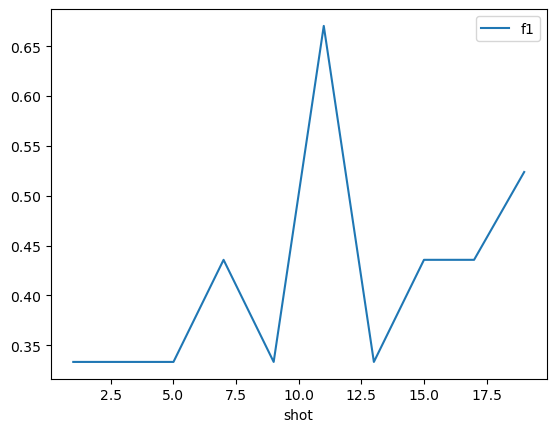

In [439]:
pd.DataFrame(metrics_shot).plot(x="shot", y="f1")

## Run evaluation on all models

In [295]:
name_text_list = ["roberta-base", "bert-base-uncased", "roberta-base"]
name_vision_list = ["google/vit-base-patch16-224", "google/vit-base-patch16-224", "openai/clip-vit-base-patch32"]
model_paths = ["./vit-roberta-finetuned/", "vit-gpt2-finetuned/", "./clip-roberta-finetuned-correct/"]


df_list = []
for name_text, name_vision, model_path in zip(name_text_list, name_vision_list, model_paths):
    print(f"{name_text} and {name_vision}")
    metrics = evaluate_dual_enc_model(path_to_test="test_data.csv",  
                                      name_text=name_text,
                                      name_vision=name_vision,
                                      path_to_model=model_path,
                                      k=100,
                                      do_checkpoints=True
                                     )
    metrics_df = pd.DataFrame(metrics)
    metrics_df = metrics_df.assign(vision_model = name_vision, 
                                   model_paths = Path(model_path).stem,
                                   text_model = name_text)
    df_list.append(metrics_df)

roberta-base and google/vit-base-patch16-224



Evaluating each pair img/text: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:09<00:00, 11.04it/s]

Evaluating each pair img/text: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:08<00:00, 11.26it/s]

Evaluating each pair img/text: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████

bert-base-uncased and google/vit-base-patch16-224



Evaluating each pair img/text: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:09<00:00, 10.53it/s]

Evaluating each pair img/text: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:09<00:00, 10.78it/s]

Evaluating each pair img/text: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████

roberta-base and openai/clip-vit-base-patch32


Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration.

Evaluating each pair img/text: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:06<00:00, 16.26it/s]

Evaluating each pair img/text: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/1

In [297]:
all_metrics = pd.concat(df_list)
all_metrics

,accuracy,f1,epoch,vision_model,model_paths,text_model
0,0.61,0.609566,4500,google/vit-base-patch16-224,vit-roberta-finetuned,roberta-base
1,0.53,0.521897,1000,google/vit-base-patch16-224,vit-roberta-finetuned,roberta-base
2,0.69,0.677600,4000,google/vit-base-patch16-224,vit-roberta-finetuned,roberta-base
3,0.54,0.527238,3000,google/vit-base-patch16-224,vit-roberta-finetuned,roberta-base
4,0.54,0.540000,3500,google/vit-base-patch16-224,vit-roberta-finetuned,roberta-base
5,0.63,0.630778,2000,google/vit-base-patch16-224,vit-roberta-finetuned,roberta-base
6,0.61,0.607008,2500,google/vit-base-patch16-224,vit-roberta-finetuned,roberta-base
7,0.62,0.616256,5000,google/vit-base-patch16-224,vit-roberta-finetuned,roberta-base
8,0.58,0.580000,1500,google/vit-base-patch16-224,vit-roberta-finetuned,roberta-base
9,0.54,0.503922,500,google/vit-base-patch16-224,vit-roberta-finetuned,roberta-base


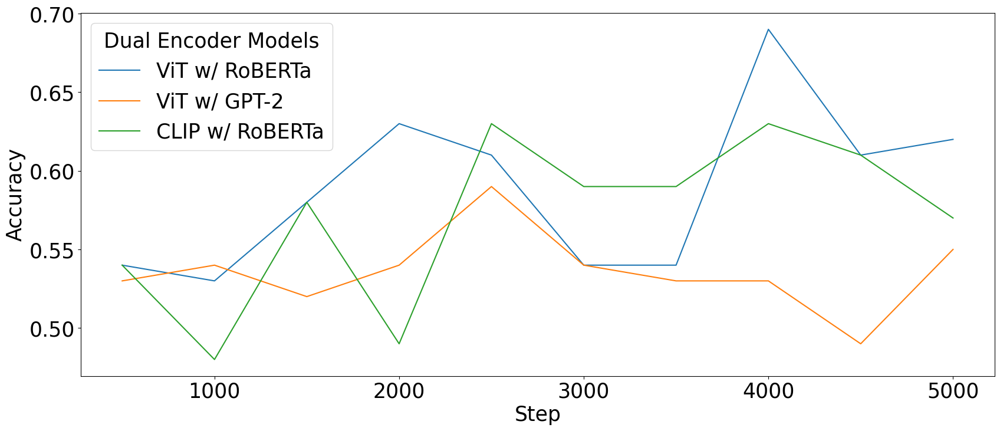

In [339]:
import seaborn as sns
import matplotlib
matplotlib.rcParams.update({'font.size': 25})

import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(20, 8))
g = sns.lineplot(x = "epoch", y = "accuracy", hue="model_paths", data = all_metrics, ax=ax)
ax.set(xlabel = "Step", ylabel = "Accuracy")


# change legend texts
new_title = "Dual Encoder Models"
g.legend_.set_title(new_title)
new_labels = ['ViT w/ RoBERTa', 'ViT w/ GPT-2', 'CLIP w/ RoBERTa']
for t, l in zip(g.legend_.texts, new_labels):
    t.set_text(l)
plt.savefig("accuracy_clip_models.png", dpi=150)

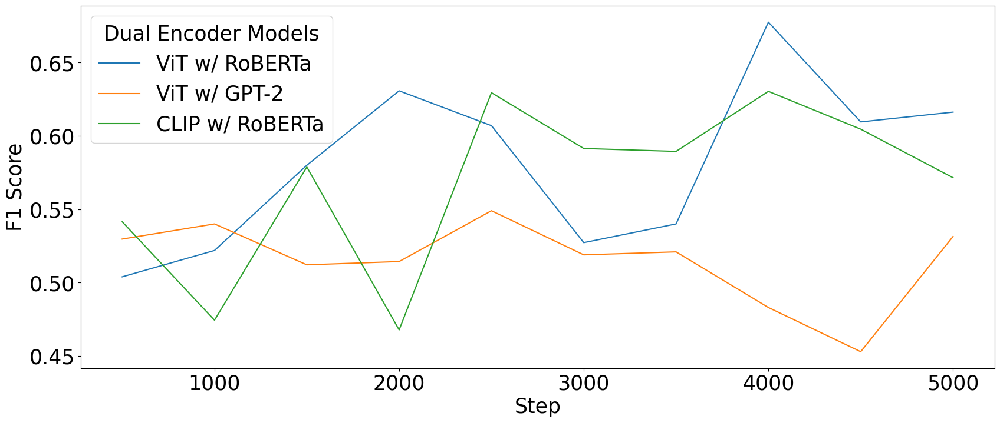

In [341]:
fig, ax = plt.subplots(figsize=(20, 8))
g = sns.lineplot(x = "epoch", y = "f1", hue="model_paths", data = all_metrics, ax=ax)
ax.set(xlabel = "Step", ylabel = "F1 Score")


# change legend texts
new_title = "Dual Encoder Models"
g.legend_.set_title(new_title)
new_labels = ['ViT w/ RoBERTa', 'ViT w/ GPT-2', 'CLIP w/ RoBERTa']
for t, l in zip(g.legend_.texts, new_labels):
    t.set_text(l)
plt.savefig("f1_clip_models.png", dpi=150)